## Create coutouts

Here is a script that does the following:

- Reads the positions (RA, DEC) from a file of LSB candidates

- Gets cutouts from the DECaLS legacy viewer - saves them as jpg images 

- Displays them in a way that allows us a convenient and fast classification

In [4]:
import numpy as np 
import urllib
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

# Adjust rc parameters to make plots pretty
def plot_pretty(dpi=200, fontsize=9):
    
    import matplotlib.pyplot as plt

    plt.rc("savefig", dpi=dpi)       # dpi resolution of saved image files
    # if you have LaTeX installed on your laptop, uncomment the line below for prettier labels
    #plt.rc('text', usetex=True)      # use LaTeX to process labels
    plt.rc('font', size=fontsize)    # fontsize
    plt.rc('xtick', direction='in')  # make axes ticks point inward
    plt.rc('ytick', direction='in')
    plt.rc('xtick.major', pad=10) 
    plt.rc('xtick.minor', pad=5)
    plt.rc('ytick.major', pad=10) 
    plt.rc('ytick.minor', pad=5)
    plt.rc('lines', dotted_pattern = [0.5, 1.1]) # fix dotted lines

    return

plot_pretty()

In [5]:
# Read the file that contains RAs and DECs of LSB candidates 
ra, dec = np.loadtxt("Region_5_Cand.dat", usecols=(0,1), unpack=3)

# Calculate the length - the number of the candidates - it is going to be useful
N_cand = len(ra)
print("Number of candidates to check is:")
print(N_cand)

Number of candidates to check is:
799


Now create the cutouts - save as jpg files all the candidates. An extra input here is the zoom. By default I will put zoom = 15, but I will write the script in a way to make this easy to change.

In [6]:
import time
zoom = 15

# Let's also time it
tim_in = time.time()

for j in range(100):
    i = j 
    
    # Give a name to the figure. Name them as "Image_cand_(i).jpb
    # Where i is the number of the candidate
    # This is easy to change to ra, dec or coadd ID or whatever...
    fig_name = "Image_cand_{0}.jpg".format(j)
    
    #Create now the name of the URL
    # This need to have as inputs (that change) the RA, DEC of each objec and zoom
    RA_loc = ra[i] #The RA of the i-th object
    DEC_loc = dec[i] # The DEC of the i-th object
    
    url_name = "http://legacysurvey.org//viewer/jpeg-cutout?ra={0}&dec={1}&zoom={2}&layer=des-dr1".format(RA_loc,DEC_loc,zoom)
    
    urllib.urlretrieve(url_name, fig_name) #Retreaves and saves each image
    
    # Leaving this here as an alternative way to do it
    #f = open(fig_name,'wb') #Open file and give name to save figure
    #f.write(urllib.urlopen(url_name).read()) #Open and read image from url
    #f.close() # Close the file
    
tim_fin = time.time()
print("Time to produce the figures (in minutes):")
print((tim_fin-tim_in)/60.0)

Time to produce the figures (in minutes):
0.937381350994


### Now display them

Let's now display them, in order to inspect and classify them

In [7]:
from IPython.display import Image
from PIL import Image

//anaconda/envs/python2/lib/python2.7/site-packages/matplotlib/figure.py:457: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


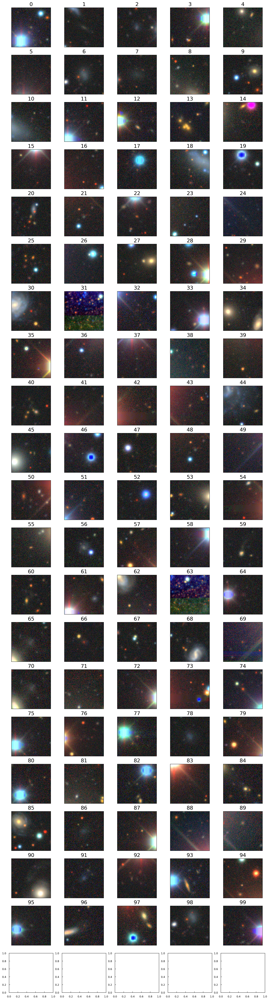

In [8]:
n_cols = 5
n_rows = int(100/n_cols)+1

fig,ax = plt.subplots(n_rows,n_cols, figsize=(16,3*n_rows))

for i in range(100):
    fig_name = "Image_cand_{0}.jpg".format(i)
    image = Image.open(fig_name)
    ax[i//5][i%5].imshow(image)
    ax[i//5][i%5].set_title("{0}".format(i), fontsize=18)
    ax[i//5][i%5].set_xticks([]) # Remove x ticks
    ax[i//5][i%5].set_yticks([]) # Remove y ticks
    
    
fig.show()

In [9]:
print(ra[603],dec[603])

(329.896324, -54.438818)


In [73]:
lala = 737
print(ra[lala],dec[lala])

(328.314523, -52.585834)
